# Object Detection with ResNet model

In [1]:
# Created by M. Massenzio, 2024-02-28
# See: https://huggingface.co/facebook/detr-resnet-50

from transformers import DetrImageProcessor, DetrForObjectDetection
from PIL import Image, ImageDraw
from IPython.display import display

import random
import requests
import torch

## Utility methods

In [2]:
def load_image(url):
    """Loads an image from a URL or local disk"""
    # if the image is from the Web
    if url.startswith('http'):
        image = Image.open(requests.get(url, stream=True).raw)
    elif url.startswith('file'):
        # the image is local
        image = Image.open(url[7:])
    return image

In [3]:
def rand_color():
    """Generates a random color"""
    r = random.randint(0, 255)
    g = random.randint(0, 255)
    b = random.randint(0, 255)
    return (r, g, b)

def draw_boxes(image, results):
    """Draws boxes and detected category around the detected object"""
    draw = ImageDraw.Draw(image)
     
    for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
        box = [round(i, 2) for i in box.tolist()]
        print(
            f"Detected {model.config.id2label[label.item()]} with confidence "       
            f"{(score.item() * 100):.2f}% at {box}"        
        )
        color = rand_color()
        draw.rectangle(box, 
                       outline=color, 
                       width=6)
        draw.text((box[0], box[1]-10), 
                  model.config.id2label[label.item()], 
                  font_size=50,
                  fill=color)

## Loading the Model directly

The code below loads a pre-trained ResNet model (FB DETR) and uses it to detect objects in the image.

In [4]:
image = load_image('file://racetrack.jpeg')

image_processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50")

inputs = image_processor(images = image, return_tensors = "pt")
outputs = model(**inputs)


The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a Ber

In [5]:
target_sizes = torch.tensor([image.size[::-1]]) 
results = image_processor.post_process_object_detection(
              outputs,
              target_sizes = target_sizes, 
              threshold = 0.7)[0]
results

{'scores': tensor([0.9287, 0.9983, 0.9965, 0.9957, 0.9965, 0.9964, 0.9986, 0.9961, 0.8259,
         0.9962, 0.9990, 0.9975], grad_fn=<IndexBackward0>),
 'labels': tensor([ 3,  3,  3,  3,  1,  3,  3,  3, 13,  3,  3,  3]),
 'boxes': tensor([[1.8165e+03, 1.6792e+03, 2.0276e+03, 1.7291e+03],
         [1.6183e+03, 1.8816e+03, 2.2350e+03, 2.1154e+03],
         [3.5102e+03, 1.9478e+03, 4.0315e+03, 2.2454e+03],
         [3.4825e+03, 2.3501e+03, 4.0318e+03, 2.7839e+03],
         [3.8093e+03, 2.4660e+03, 4.0322e+03, 2.9411e+03],
         [1.1331e+03, 1.8700e+03, 1.6477e+03, 2.0610e+03],
         [8.7105e+02, 2.0388e+03, 1.6858e+03, 2.3788e+03],
         [7.5245e-01, 1.9645e+03, 3.7328e+02, 2.2171e+03],
         [2.9129e+03, 1.5908e+03, 2.9975e+03, 1.6829e+03],
         [1.9011e+02, 1.9845e+03, 8.4488e+02, 2.2681e+03],
         [1.6840e+03, 2.0879e+03, 2.7755e+03, 2.5203e+03],
         [2.3830e+03, 1.8941e+03, 3.1610e+03, 2.1693e+03]],
        grad_fn=<IndexBackward0>)}

Detected car with confidence 92.87% at [1816.5, 1679.18, 2027.64, 1729.05]
Detected car with confidence 99.83% at [1618.33, 1881.61, 2234.98, 2115.44]
Detected car with confidence 99.65% at [3510.22, 1947.77, 4031.55, 2245.4]
Detected car with confidence 99.57% at [3482.47, 2350.05, 4031.84, 2783.93]
Detected person with confidence 99.65% at [3809.26, 2466.04, 4032.21, 2941.06]
Detected car with confidence 99.64% at [1133.05, 1870.03, 1647.71, 2060.96]
Detected car with confidence 99.86% at [871.05, 2038.78, 1685.79, 2378.83]
Detected car with confidence 99.61% at [0.75, 1964.53, 373.28, 2217.08]
Detected stop sign with confidence 82.59% at [2912.93, 1590.83, 2997.55, 1682.86]
Detected car with confidence 99.62% at [190.11, 1984.52, 844.88, 2268.12]
Detected car with confidence 99.90% at [1683.99, 2087.91, 2775.48, 2520.29]
Detected car with confidence 99.75% at [2383.05, 1894.12, 3160.99, 2169.28]


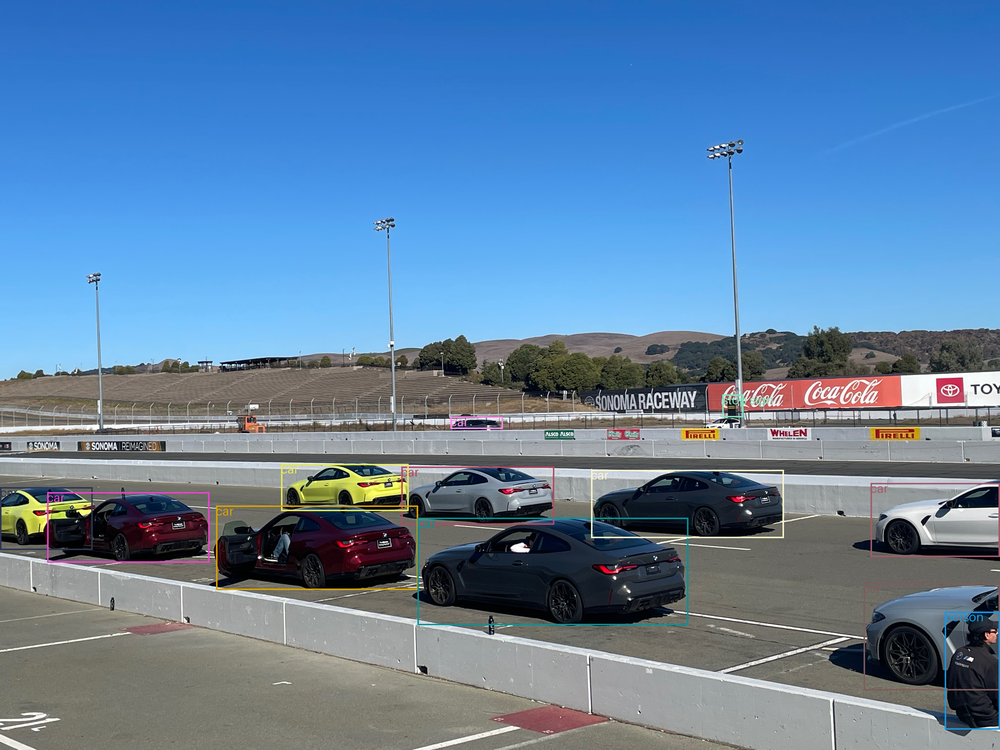

In [6]:
draw_boxes(image, results)
display(image)

## Using Hugging Face transformers Pipeline

In [7]:
from transformers import pipeline

image = load_image('file://racetrack.jpeg')

detection = pipeline("object-detection", model="facebook/detr-resnet-50")
results = detection(image)
results[:3]


Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Could not find image processor class in the image processor config or the model conf

[{'score': 0.9286917448043823,
  'label': 'car',
  'box': {'xmin': 1816, 'ymin': 1679, 'xmax': 2027, 'ymax': 1729}},
 {'score': 0.9982571005821228,
  'label': 'car',
  'box': {'xmin': 1618, 'ymin': 1881, 'xmax': 2234, 'ymax': 2115}},
 {'score': 0.9964500665664673,
  'label': 'car',
  'box': {'xmin': 3510, 'ymin': 1947, 'xmax': 4031, 'ymax': 2245}}]

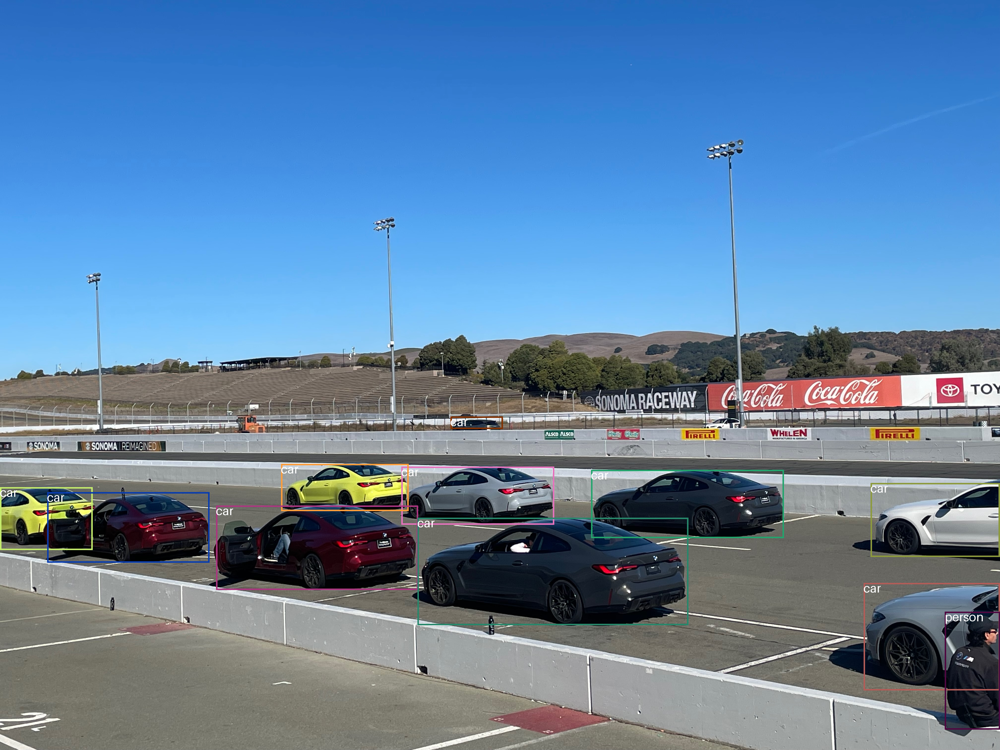

In [8]:
def draw_boxes2(image, results, threshold=0.9):
    draw = ImageDraw.Draw(image)
 
    for object in results:
        if object['score'] > threshold:
            box = [i for i in object['box'].values()]
            draw.rectangle(box,
                           outline=rand_color(),
                           width=6)
            draw.text((box[0], box[1]-10), 
                      object['label'], 
                      font_size=50,
                      fill='white')
    
draw_boxes2(image, results)
display(image)